## ROH analysis

This notebook analyses the output of bcftools ROH, and plots the joint distribution of fROH and nROH per-individual

In [34]:
import sgkit as sg
import hmmlearn
import json
import hashlib
import allel
import plotly.express as px
import kaleido
import seaborn as sns
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import itertools as it
import multiprocessing
from sklearn.mixture import GaussianMixture
from sklearn.utils.extmath import row_norms

In [2]:
#load data and define utility vars

#load and filter metadata
df_samples = pd.read_csv('/Users/dennistpw/Projects/AsGARD/metadata/cease_combinedmetadata_qcpass.20240914.csv')

#chrom dict
scaflens={'CM023248' : 93706023,
'CM023249' : 88747589,
'CM023250' : 22713616}

#px config
config = {
  'toImageButtonOptions': {
    'format': 'png', # one of png, svg, jpeg, webp
    'filename': 'custom_image',
    'height': 500,
    'width': 700,
    'scale':6 # Multiply title/legend/axis/canvas sizes by this factor
  }
}

#palette
countrycols = {
'Afghanistan' : '#a6cee3',
'Pakistan' : '#1f78b4',
'India' : '#b2df8a',
'SaudiArabia' : '#33a02c',
'Ethiopia': '#fb9a99',
'Djibouti' : '#e31a1c',
'Sudan' : '#fdbf6f',
'Yemen' : '#ff7f00'}

analysis_popcols =  {'saudi_e': '#6a3d9a',
'saudi_r': '#cab2d6',
'india_m': '#a6cee3',
 'india_b': '#1f78b4',
 'afgh_pak': '#ff7f00',
 'djibouti': '#e31a1c',
 'ethiopia_n': '#33a02c',
 'ethiopia_so': '#b2df8a',
 'yemen': '#fdbf6f',
 'sudan': '#fb9a99'}

In [16]:
#some helper functions

#hashing func
def hash_params(*args, **kwargs):
    """Helper function to hash analysis parameters."""
    o = {
        'args': args,
        'kwargs': kwargs
    }
    s = json.dumps(o, sort_keys=True).encode()
    h = hashlib.md5(s).hexdigest()
    return h

def infer_roh(ind, chrom, analysis_name, results_dir):

    # construct a key to save the results under
    results_key = hash_params(
        #region=region,
        #sample_sets=sample_sets,
        ind=ind,
        chrom=chrom,
        analysis_name=analysis_name
    )

    # define paths for results files
    data_path = f'{results_dir}/{results_key}-roh.csv'

    try:
        # try to load previously generated results
        df_roh = pd.read_csv(data_path)
        return df_roh
    except FileNotFoundError:
        # no previous results available, need to run analysis
        print(f'running analysis: {results_key}')

    # load data
    ds = sg.load_dataset(f'/Users/dennistpw/Projects/AsGARD/data/variants_combined_cohorts/combined_cohorts.{chrom}.zarr')

    #get gts for our ind only
    # locate selected samples
    loc_samples = df_samples['sample_id'] == ind
    ds = ds.isel(samples=loc_samples)

    # subset to accessible sites only
    print('subsetting to accessible sites only')
    accmask = ds['is_accessible'].compute()
    ds = ds.sel(variants=(accmask))
    gt = allel.GenotypeArray(ds['call_genotype'])
    gt = gt[:,0]

    #get pos
    pos = ds['variant_position'].compute()

    #get roh
    print(f'computing ROH for {ind}, {chrom}')
    df_roh = allel.roh_mhmm(gv=gt, pos=pos, contig_size = scaflens[chrom])[0]
    df_roh['ind'] = ind
    df_roh['chrom'] = chrom
    
    
    #save
    df_roh.to_csv(data_path, index=False)
    print(f'saved results: {results_key}')
    return(df_roh)


In [39]:
rohlist = []
for chrom in scaflens.keys():
    for ind in df_samples['sample_id']:
        roh_df = infer_roh(ind, chrom, 'default', '../data/roh_20240920/')
        rohlist.append(roh_df)

running analysis: 84b39d64695d1c4ee07d1ca20c4ff794
subsetting to accessible sites only
computing ROH for AfNC7, CM023248
saved results: 84b39d64695d1c4ee07d1ca20c4ff794
running analysis: 002a5e7565410b5e72ffbebd273a44a9
subsetting to accessible sites only
computing ROH for AfND7, CM023248
saved results: 002a5e7565410b5e72ffbebd273a44a9
running analysis: 0f0a7ad52ff41d21725eca4ef8961767
subsetting to accessible sites only
computing ROH for AfND8, CM023248
saved results: 0f0a7ad52ff41d21725eca4ef8961767
running analysis: a3456dafb191ab0ea7b7d4be94e9b4c0
subsetting to accessible sites only
computing ROH for AfNE1, CM023248
saved results: a3456dafb191ab0ea7b7d4be94e9b4c0
running analysis: 5604f68e69f395f8926b9737eb02be35
subsetting to accessible sites only
computing ROH for AfNE6, CM023248
saved results: 5604f68e69f395f8926b9737eb02be35
running analysis: b1b37c25c1413af69718c9ca7c5da91b
subsetting to accessible sites only
computing ROH for AfNE7, CM023248
saved results: b1b37c25c1413af6971

In [25]:
#have a look at total length distribution by chrom
fig = px.histogram(roh_data, x="length", facet_col='chrom')
fig.show()

Ok, the long tail makes this distribution impossible to visualise - let's try truncating the tail

In [26]:
#have a look at total length distribution by chrom - with length filter of < 50k
fig = px.histogram(roh_data[roh_data['length'] < 50000], x="length", facet_col='chrom')
fig.show()

This is more informative - most ROH in the genome are below 20kb. In Ag1000G they use a length cutoff of 100k.
The scale of LD is important for understanding whether we are falsely inferring short linkage blocks with ROH. However, short LD blocks are still reflective of ancestral demographic events. Pemberton sheep study examines ROH/IBD length over different categories, so let's try this here with: all segments, segments > 100kb only, segments over 1Mb only, and short (<100kb segments>) only.

In [49]:
def plot_roh(
        roh_df = roh_data,
        length = 1000,
        attr1 = 'fROH',
        attr2 = 'count',
        colour='analysis_pop',
        tit = 'allel',
        metadata = df_samples,
        jkey = 'ind', #col identifying individual
        admixtab = False,
        palette = px.colors.qualitative.Plotly,
        labs = (f"nROH > 1kb", 'fROH', 'State'), #tuple of labels
        **kwargs,
        ):
    
    #aggregate roh data and join to metadata, get fraction of genome in roh
    roh_df = roh_df[roh_df['length'] > length]

    roh_data_agg = []
    roh_data_agg = roh_df.groupby(jkey)['length'].agg(['count', 'sum', 'median', 'skew'])
    roh_data_agg['fROH'] = roh_data_agg['sum'] / sum(scaflens.values())
    metadata = metadata.set_index(jkey, drop=False)
    roh_data_agg = roh_data_agg.join(metadata)
    roh_data_agg['size'] = 1 #hack to enable size control of pts


    #let's see what happens when we colour our points by admixture pop assignment

    if (admixtab == True):
        admixdata = pd.read_csv('../admixture_20230915/k9_table.txt', sep='\t')
        admixdata = admixdata.set_index('callset_order')
        roh_data_agg = roh_data_agg.set_index('callset_order')
        roh_data_agg = roh_data_agg.merge(admixdata)
        roh_data_agg['max_prob'] = roh_data_agg['max_prob'].astype(object)
    
    #define plot options
    plot_kwargs = dict(
        width=800,
        height=600,
        template='simple_white',
        hover_name='sample_id',
        title = f'{tit} ROH output, length > {length}',
        hover_data=[
            'sample_id',
            'admin1_name',
            'location', 
            'country', 
        ],
        size='size',
        color_discrete_map = palette,
        size_max=8,
        opacity=0.9,
        render_mode='svg',
    )

    # apply any user overrides
    plot_kwargs.update(kwargs)


    fig = px.scatter(roh_data_agg,
            x = attr1,
            y = attr2,
            color=colour,
            labels={attr1: labs[0],
                    attr2: labs[1],
                    'state': labs[2]},
                    **plot_kwargs)
    fig.show()

    return(roh_data_agg)


While we're doing this, let's analyse bcftools roh output alongside.

In [27]:
cols = ['#a6cee3','#1f78b4','#b2df8a','#33a02c','#fb9a99','#e31a1c','#fdbf6f','#ff7f00','#cab2d6']

plot_roh(attr2 = 'count',
         length=0,
         roh_df=roh_data,
         jkey = 'sample_id',
         tit = 'bcftools',
         palette=analysis_popcols,
         labs = ('fROH', "Count Segs",'State'))

Some interesting signals here - clearly more ROH in Saudi and India, afgh and pak but at least in the native range, esp in afgh.pak, F tends to be much lower. Perhaps as this is the much more established population? Much longer tails, much higher F in invasive population.

In [29]:
plot_roh(attr2 = 'count',
         length=25_000,
         roh_df=roh_data,
         jkey = 'sample_id',
         tit = 'bcftools',
        palette=analysis_popcols,
         labs = ('fROH', "Count Segs",'State'))

Applying a 25kb length filter removes most of the Pakistan and Yemeni segments

In [50]:
roh_agg = plot_roh(attr2 = 'count',
         length=100_000,
         roh_df=roh_data,
         jkey = 'sample_id',
         tit = 'bcftools',
        palette=analysis_popcols,
         labs = ('fROH', "Count Segs",'Country'))



Now they begin to resemble each other much more. bcftools seems to generally call more ROH than scikit allel. Which one do we pick?

In [33]:
plot_roh(attr2 = 'count',
         length=1e6,
         roh_df=roh_data,
         jkey = 'sample_id',
         tit = 'bcftools',
        palette=analysis_popcols,
         labs = ('fROH', "Count Segs",'Country'))

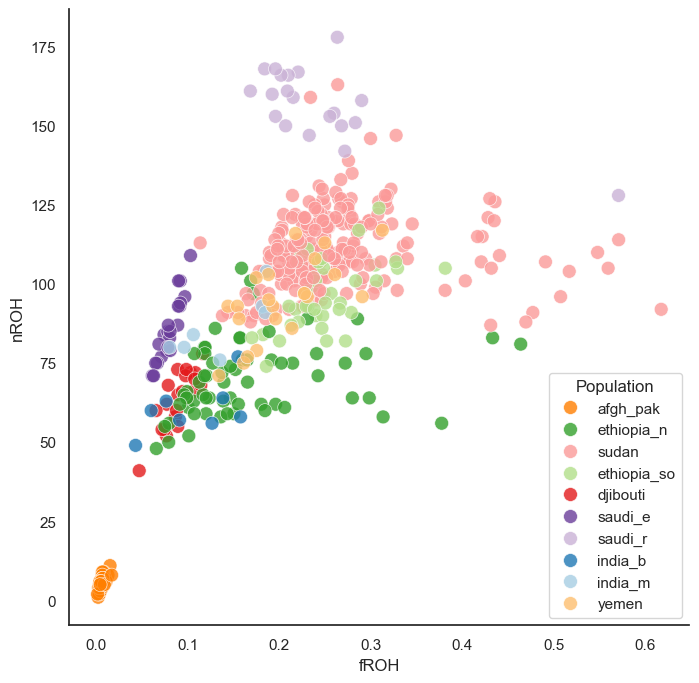

In [73]:
# Plot for paper
def plot_roh_for_paper(df, figname):


    sns.set_theme(rc={'figure.figsize':(8,8)}, style="white")

    scatter_kws = {
        's': 100,  # Point size
        'edgecolor': 'white',  # Thin white boundary
        'linewidth': 0.5,  # Thickness of the boundary
        'alpha': 0.8  # Point opacity (80% opacity)
    } 


    # Plot the first scatterplot
    g = sns.scatterplot(data=df, x='fROH', y='count', hue='analysis_pop', palette=analysis_popcols, **scatter_kws)
    
    g.set(xlabel='fROH', ylabel='nROH')

    g.legend(title='Population')


    # Despine the axes
    sns.despine()

    plt.savefig(f'../figures/{figname}.svg', format='svg')


plot_roh_for_paper(roh_agg,' roh_1e5.svg')

We can see that the properties of the f/nROH distribution differ by length. The literature suggests that inference of ROH shorter than the typical LD length is prone to artefacts (though the distinction between ROH and LD segments as relics of ancestry is unclear, as LD segments are also indicative of ancestry, albeit in the recent past).

Many populations show signs of extreme inbreeding - fROH of 0.2 is still quite high for mosquitoes! Even for humans, some of the more inbred human pops (see Ceballos, 2018) have fROH of around 0.1, and An. gambiae for the most part are below 0.1.

Different demographic events leave footprints in the length and number of ROH in the genome. Thus, it is possible to date demographic events based on different ROH distributions. Each population and species has specific ROH characteristics - see [Pemberton et al, 2012](https://www.cell.com/ajhg/pdf/S0002-9297(12)00323-0.pdf). This paper (and other subsequently) apply clustering approaches to identify different categories of ROH lengths in different population.

Pemberton paper uses `mclust` in R - this is a Gaussian mixture based model for clustering data. This method is also implemented in `scikit-learn`. A Gaussian mixture model is a probabilistic model that assumes all data points are generated from a mixture of finite Gaussians with unknown parameters. Mixture models generalise k-means clustering to incorporate information about the covariance of the data. K-means is an algorithm, where GMM is a model.

Another interesting paper on ROH distributions, this time in soay sheep uses the expected generation time and recombination rate to infer likely ROH ages. The equation g = 100 / (2rL) where g = generation time (years), r = recombination rate in cm/Mb-1, and L = segment length in Mb, can be used to date ROH segments. Assuming a recombination rate similar to An. gambiae - a genomewide average of around 1cm/Mb-1, or dividing the corrected (see (this paper)[https://academic.oup.com/genetics/article/153/1/251/6047849#325536228]) chr 2 linkage map length by chrom 2 length in bp (128/93.1), yields a genomewide average of around 1.37cm/Mb-1. An example then - for a group of ROH with length 1Mb, we would expect these to be 37 generations old? Assuming a generation time in Anopheles of around 11 (verify/modify this for a range), that puts a 1Mb segment to be around 3 years old.

Let's develop this a little bit - here's a function that will infer the ages of ROH segments based on this equation.

In [36]:
r=1
g=11
roh_df = roh_data[roh_data['qual'] > 30]
roh_df = roh_df[roh_df['length'] > 100_000] #length filter to be decided once we;ve done LD decay again
def age_roh(L, gen=11): #needs length IN BP
    #return age in years of ROH segment based on rec rate and length of segment in Mb, and gen time of 11 gens/year
    age_y = (100 / (2*r*(L/1e6))) / 11
    return(age_y)

vf = np.vectorize(age_roh)

roh_ages = vf(roh_df['length'])

roh_df['age_y'] = roh_ages

roh_df['sample_id'] = roh_df['sample_id'].astype('object')
df_samples['sample_id'] = df_samples['sample_id'].astype('object')
roh_df = pd.merge(roh_df, df_samples, how='left')

fig = px.scatter(roh_df,
        x = 'length',
        y = 'age_y',
        color='analysis_pop',
        facet_col="analysis_pop",
        facet_col_wrap=4,
        color_discrete_map=analysis_popcols,
        hover_data=[
            'sample_id',
            'location']
        )
fig.show()

<Axes: xlabel='length', ylabel='age_y'>

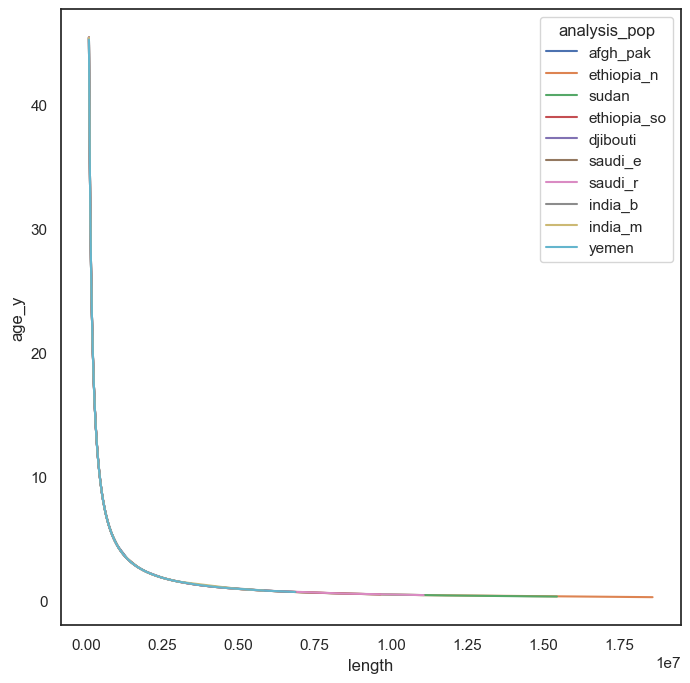

In [74]:
sns.lineplot(data=roh_df, x='length', y='age_y', hue='analysis_pop')

In [ ]:
sns.lineplot(data=roh_df, x='length', y='age_y', hue='analysis_pop')


I've arbitrarily cut off ROH segment lengths at 15y ago (eg around 300bp long).

How would ROH segments / IBD segments appear with respect to distinct demographic events?

Would it be possible to find specific bottlenecks in different subpopulations by looking at ROH in all individuals, or would we need to identify specific populations first? Would methods like IBD segment techniques, or ARG inference techniques be more informative inasmuch as they would infer not only the presence of homozygous segments but also their sharing between individuals? This is probably the way to go!

However, there's probably some useful stuff here too - let's try:
1. Rerunning clustering algorithms to see if we can ID specific clusters of ROH lengths and ages.
2. refine our ROH aging by:
    1. Generating scenarios of putative ROH ages for different generation times.
    2. mapping chromosome genetic length (in cm) with physical length, per chrom (based on the recombination rate paper?).
3. Plot ROH ages/lengths, do clustering, and joint dist plotting (for length, count, skew) coloured not only by state but by primary admix proportion.



In [ ]:
statepal

{'Northern': '#a6cee3',
 'RiverNile': '#1f78b4',
 'Khartoum': '#b2df8a',
 'RedSea': '#33a02c',
 'WhiteNile': '#fb9a99',
 'Gezira': '#e31a1c',
 'Sennar': '#fdbf6f',
 'Gedaref': '#ff7f00',
 'Kassala': '#cab2d6',
 'AdenCity': '#6a3d9a',
 'KhyberPakhtunkhwa': '#b15928',
 'Yemen': '#6a3d9a'}

In [ ]:
#clustering in all individuals
#all states
#all admix-inferred pops

#also try on n/froh - i wonder how it will classify the pops?

#gaussian mixture model clustering is

In [ ]:
roh_data = roh_data[roh_data['length'] > 100000]

In [ ]:
#le'ts try fit a model according to the sklearn docs

#generate 1d array with our roh data
rohlen = np.array(bcftools_roh_data['length']).reshape(-1,1)

from sklearn.mixture import GaussianMixture
from sklearn.model_selection import GridSearchCV

#------------------------------------------------------------
# Learn the best-fit GaussianMixture models
#  Here we'll use scikit-learn's GaussianMixture model. The fit() method
#  uses an Expectation-Maximization approach to find the best
#  mixture of Gaussians for the data

# fit models with 1-10 components
N = np.arange(1, 11)
models = [None for i in range(len(N))]

for i in range(len(N)):
    models[i] = GaussianMixture(N[i]).fit(rohlen)

# compute the AIC and the BIC
AIC = [m.aic(rohlen) for m in models]
BIC = [m.bic(rohlen) for m in models]


In [ ]:
x = np.linspace(-6, 6, 1000)
logprob = M_best.score_samples(x.reshape(-1, 1))
responsibilities = M_best.predict_proba(x.reshape(-1, 1))
pdf = np.exp(logprob)
pdf_individual = responsibilities * pdf[:, np.newaxis]

In [ ]:
px.histogram(rohlen)

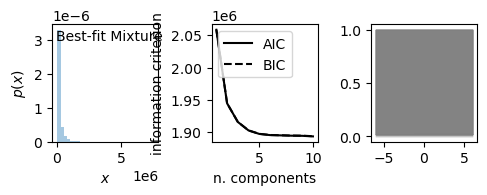

In [ ]:
#------------------------------------------------------------
# Plot the results
#  We'll use three panels:
#   1) data + best-fit mixture
#   2) AIC and BIC vs number of components
#   3) probability that a point came from each component

fig = plt.figure(figsize=(5, 1.7))
fig.subplots_adjust(left=0.12, right=0.97,
                    bottom=0.21, top=0.9, wspace=0.5)
# plot 1: data + best-fit mixture
ax = fig.add_subplot(131)
M_best = models[np.argmin(AIC)]

x = np.linspace(-6, 6, 1000)
logprob = M_best.score_samples(x.reshape(-1, 1))
responsibilities = M_best.predict_proba(x.reshape(-1, 1))
pdf = np.exp(logprob)
pdf_individual = responsibilities * pdf[:, np.newaxis]

ax.hist(rohlen, 30, density=True, histtype='stepfilled', alpha=0.4)
ax.plot(x, pdf, '-k')
ax.plot(x, pdf_individual, '--k')
ax.text(0.04, 0.96, "Best-fit Mixture",
        ha='left', va='top', transform=ax.transAxes)
ax.set_xlabel('$x$')
ax.set_ylabel('$p(x)$')

# plot 2: AIC and BIC
ax = fig.add_subplot(132)
ax.plot(N, AIC, '-k', label='AIC')
ax.plot(N, BIC, '--k', label='BIC')
ax.set_xlabel('n. components')
ax.set_ylabel('information criterion')
ax.legend(loc=2)

# plot 3: posterior probabilities for each component
ax = fig.add_subplot(133)

p = responsibilities # rearrange order so the plot looks better
p = p.cumsum(1).T

ax.fill_between(x, 0, p[0], color='gray', alpha=0.3)
ax.fill_between(x, p[0], p[1], color='gray', alpha=0.5)
ax.fill_between(x, p[1], 1, color='gray', alpha=0.7)
ax.fill_between(x, p[2], 1, color='gray', alpha=0.7)
ax.fill_between(x, p[3], 1, color='gray', alpha=0.7)


plt.show()

In [ ]:
p

array([[1.13796443e-08, 1.13796347e-08, 1.13796252e-08, ...,
        1.13701261e-08, 1.13701165e-08, 1.13701070e-08],
       [9.16523281e-01, 9.16523181e-01, 9.16523081e-01, ...,
        9.16423183e-01, 9.16423082e-01, 9.16422982e-01],
       [9.16523372e-01, 9.16523272e-01, 9.16523172e-01, ...,
        9.16423274e-01, 9.16423173e-01, 9.16423072e-01],
       ...,
       [9.70000906e-01, 9.70000771e-01, 9.70000635e-01, ...,
        9.69865727e-01, 9.69865591e-01, 9.69865456e-01],
       [9.99999994e-01, 9.99999994e-01, 9.99999994e-01, ...,
        9.99999994e-01, 9.99999994e-01, 9.99999994e-01],
       [1.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        1.00000000e+00, 1.00000000e+00, 1.00000000e+00]])

In [ ]:
M_best

GaussianMixture(n_components=10)

/home/dennist/miniconda3/envs/ceasebasic/lib/python3.10/site-packages/seaborn/axisgrid.py:118: UserWarning:

The figure layout has changed to tight



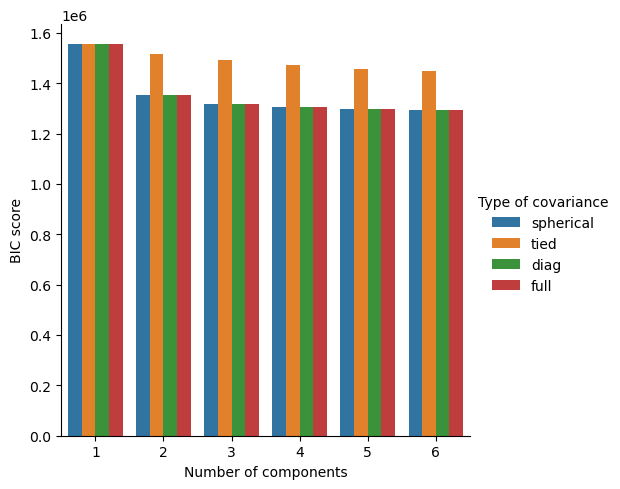

In [ ]:
sns.catplot(
    data=df,
    kind="bar",
    x="Number of components",
    y="BIC score",
    hue="Type of covariance",
)
plt.show()